In [338]:
import pandas as pd; pd.options.mode.chained_assignment = None
import numpy as np

# Built In Imports
from datetime import datetime
from glob import glob
import warnings
import IPython
import urllib
import zipfile
import pickle
import shutil
import string
import math
import tqdm
import time
import os
import gc
import re
import random
from pprint import pprint

# Visualization Imports
from matplotlib.colors import ListedColormap
import matplotlib.patches as patches
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.offline as pyo
pyo.init_notebook_mode()
import seaborn as sns
from PIL import Image
import matplotlib
import plotly
import PIL
import cv2
from pycocotools.coco import COCO

# Other Imports
from tqdm.notebook import tqdm

LABEL_COLORS = [px.colors.label_rgb(px.colors.convert_to_RGB_255(x)) for x in sns.color_palette("Spectral", 10)]
LABEL_COLORS_WOUT_NO_FINDING = LABEL_COLORS[:8]+LABEL_COLORS[9:]

In [339]:
import json
with open('./dataset/train.json', 'r') as f:
    a = json.load(f)

In [340]:
a.keys()

dict_keys(['info', 'licenses', 'images', 'categories', 'annotations'])

In [341]:
a['info']

{'year': 2021,
 'version': '1.0',
 'description': 'Recycle Trash',
 'contributor': 'Upstage',
 'url': None,
 'date_created': '2021-02-02 01:10:00'}

In [342]:
a['licenses']

[{'id': 0,
  'name': 'CC BY 4.0',
  'url': 'https://creativecommons.org/licenses/by/4.0/deed.ast'}]

In [343]:
a['images']

[{'width': 1024,
  'height': 1024,
  'file_name': 'train/0000.jpg',
  'license': 0,
  'flickr_url': None,
  'coco_url': None,
  'date_captured': '2020-12-26 14:44:23',
  'id': 0},
 {'width': 1024,
  'height': 1024,
  'file_name': 'train/0001.jpg',
  'license': 0,
  'flickr_url': None,
  'coco_url': None,
  'date_captured': '2021-01-10 16:30:39',
  'id': 1},
 {'width': 1024,
  'height': 1024,
  'file_name': 'train/0002.jpg',
  'license': 0,
  'flickr_url': None,
  'coco_url': None,
  'date_captured': '2020-12-27 17:55:52',
  'id': 2},
 {'width': 1024,
  'height': 1024,
  'file_name': 'train/0003.jpg',
  'license': 0,
  'flickr_url': None,
  'coco_url': None,
  'date_captured': '2021-03-31 12:10:36',
  'id': 3},
 {'width': 1024,
  'height': 1024,
  'file_name': 'train/0004.jpg',
  'license': 0,
  'flickr_url': None,
  'coco_url': None,
  'date_captured': '2021-01-01 18:52:38',
  'id': 4},
 {'width': 1024,
  'height': 1024,
  'file_name': 'train/0005.jpg',
  'license': 0,
  'flickr_url': 

In [344]:
a['categories']

[{'id': 0, 'name': 'General trash', 'supercategory': 'General trash'},
 {'id': 1, 'name': 'Paper', 'supercategory': 'Paper'},
 {'id': 2, 'name': 'Paper pack', 'supercategory': 'Paper pack'},
 {'id': 3, 'name': 'Metal', 'supercategory': 'Metal'},
 {'id': 4, 'name': 'Glass', 'supercategory': 'Glass'},
 {'id': 5, 'name': 'Plastic', 'supercategory': 'Plastic'},
 {'id': 6, 'name': 'Styrofoam', 'supercategory': 'Styrofoam'},
 {'id': 7, 'name': 'Plastic bag', 'supercategory': 'Plastic bag'},
 {'id': 8, 'name': 'Battery', 'supercategory': 'Battery'},
 {'id': 9, 'name': 'Clothing', 'supercategory': 'Clothing'}]

In [345]:
a['annotations']

[{'image_id': 0,
  'category_id': 0,
  'area': 257301.66,
  'bbox': [197.6, 193.7, 547.8, 469.7],
  'iscrowd': 0,
  'id': 0},
 {'image_id': 1,
  'category_id': 3,
  'area': 10402.56,
  'bbox': [0.0, 407.4, 57.6, 180.6],
  'iscrowd': 0,
  'id': 1},
 {'image_id': 1,
  'category_id': 7,
  'area': 26259.36,
  'bbox': [0.0, 455.6, 144.6, 181.6],
  'iscrowd': 0,
  'id': 2},
 {'image_id': 1,
  'category_id': 4,
  'area': 69096.17,
  'bbox': [722.3, 313.4, 274.3, 251.9],
  'iscrowd': 0,
  'id': 3},
 {'image_id': 1,
  'category_id': 5,
  'area': 24164.58,
  'bbox': [353.2, 671.0, 233.7, 103.4],
  'iscrowd': 0,
  'id': 4},
 {'image_id': 1,
  'category_id': 5,
  'area': 188324.4,
  'bbox': [3.7, 448.5, 778.2, 242.0],
  'iscrowd': 0,
  'id': 5},
 {'image_id': 1,
  'category_id': 0,
  'area': 38908.72,
  'bbox': [425.3, 681.9, 216.4, 179.8],
  'iscrowd': 0,
  'id': 6},
 {'image_id': 1,
  'category_id': 7,
  'area': 7391.52,
  'bbox': [92.4, 601.7, 139.2, 53.1],
  'iscrowd': 0,
  'id': 7},
 {'image_

In [346]:
coco = COCO('./dataset/train.json')

train_df = pd.DataFrame()

image_ids = []
class_name = []
class_id = []
x_min = []
y_min = []
x_max = []
y_max = []
classes = ["General trash", "Paper", "Paper pack", "Metal", "Glass", 
           "Plastic", "Styrofoam", "Plastic bag", "Battery", "Clothing"]
for image_id in coco.getImgIds():
        
    image_info = coco.loadImgs(image_id)[0]
    ann_ids = coco.getAnnIds(imgIds=image_info['id'])
    anns = coco.loadAnns(ann_ids)
        
    file_name = image_info['file_name']
        
    for ann in anns:
        image_ids.append(file_name)
        class_name.append(classes[ann['category_id']])
        class_id.append(ann['category_id'])
        x_min.append(float(ann['bbox'][0]))
        y_min.append(float(ann['bbox'][1]))
        x_max.append(float(ann['bbox'][0]) + float(ann['bbox'][2]))
        y_max.append(float(ann['bbox'][1]) + float(ann['bbox'][3]))

train_df['image_id'] = image_ids
train_df['class_name'] = class_name
train_df['class_id'] = class_id
train_df['x_min'] = x_min
train_df['y_min'] = y_min
train_df['x_max'] = x_max
train_df['y_max'] = y_max

loading annotations into memory...
Done (t=0.44s)
creating index...
index created!


In [347]:
train_df

,image_id,class_name,class_id,x_min,y_min,x_max,y_max
0,train/0000.jpg,General trash,0,197.6,193.7,745.4,663.4
1,train/0001.jpg,Metal,3,0.0,407.4,57.6,588.0
2,train/0001.jpg,Plastic bag,7,0.0,455.6,144.6,637.2
3,train/0001.jpg,Glass,4,722.3,313.4,996.6,565.3
4,train/0001.jpg,Plastic,5,353.2,671.0,586.9,774.4
...,...,...,...,...,...,...,...
23139,train/4882.jpg,Plastic,5,0.0,116.2,944.1,930.3
23140,train/4882.jpg,Plastic bag,7,302.1,439.3,567.3,655.4
23141,train/4882.jpg,General trash,0,511.3,451.1,570.0,481.3
23142,train/4882.jpg,Paper,1,255.0,421.4,526.7,616.5


In [348]:
def plot_image_img(img):
    clr = {
    'Paper' : 'red',
    'Plastic bag' : 'gold',
    'General trash' : 'palegreen',
    'Plastic' : 'aqua',
    'Stryofoam' : 'darkblue',
    'Glass' : 'lightpink',
    'Metal' : 'darksalmon',
    'Paper pack' : 'grey',
    'Clothing' : 'black',
    'Battery' : 'brown'
    }
    image_idx = [idx for idx, id in enumerate(train_df['image_id']) if str(img).zfill(4) in id]
    image_id = os.path.join('train', str(img).zfill(4) + '.jpg')
    bboxes = []
    for idx in image_idx:
        x_min = train_df['x_min'][idx]
        y_min = train_df['y_min'][idx]
        width = train_df['x_max'][idx] - x_min
        height = train_df['y_max'][idx] - y_min
        cls = train_df['class_name'][idx]
        bboxes.append([x_min, y_min, width, height, cls])
        
    img = Image.open(os.path.join('./dataset', image_id))
    
    fig, ax = plt.subplots(1, 1, figsize = (20,20))
    ax.imshow(img)
    for bbox in bboxes:
        ax.add_patch(patches.Rectangle((bbox[0], bbox[1]), 
                                       bbox[2], bbox[3], 
                                       fill = False, 
                                       linewidth = 4,
                                       edgecolor = clr[bbox[4]]))
    uniqcol = set([bbox[4] for bbox in bboxes])
    ax.legend([ax.add_patch(patches.Rectangle((0,0),
                                              0,0,
                                              fill = False, linewidth = 4,
                                              edgecolor = clr[col],
                                              label = col)) for col in uniqcol], [col for col in uniqcol],
              fontsize = 'xx-large')
    plt.title(f"{image_id}", fontsize = 'xx-large')
    plt.axis('off')
    plt.show()
    
    
def plot_image_idx(idx):
    clr = {
    'Paper' : 'red',
    'Plastic bag' : 'gold',
    'General trash' : 'palegreen',
    'Plastic' : 'aqua',
    'Stryofoam' : 'darkblue',
    'Glass' : 'lightpink',
    'Metal' : 'darksalmon',
    'Paper pack' : 'grey',
    'Clothing' : 'black',
    'Battery' : 'brown'
    }
    
    image_id = train_df['image_id'][idx]
    x_min = train_df['x_min'][idx]
    y_min = train_df['y_min'][idx]
    width = train_df['x_max'][idx] - x_min
    height = train_df['y_max'][idx] - y_min
    cls = train_df['class_name'][idx]
    bbox = [x_min, y_min, width, height, cls]
    
    img = Image.open(os.path.join('./dataset', image_id))
    
    fig, ax = plt.subplots(1, 1, figsize = (20,20))
    ax.imshow(img)
    ax.add_patch(patches.Rectangle((bbox[0], bbox[1]), 
                                   bbox[2], bbox[3], 
                                   fill = False, 
                                   linewidth = 4,
                                   edgecolor = clr[bbox[4]],
                                   label = bbox[4]))

    ax.legend(fontsize = 'xx-large')
    plt.title(f"{image_id}", fontsize = 'xx-large')
    plt.axis('off')
    plt.show()

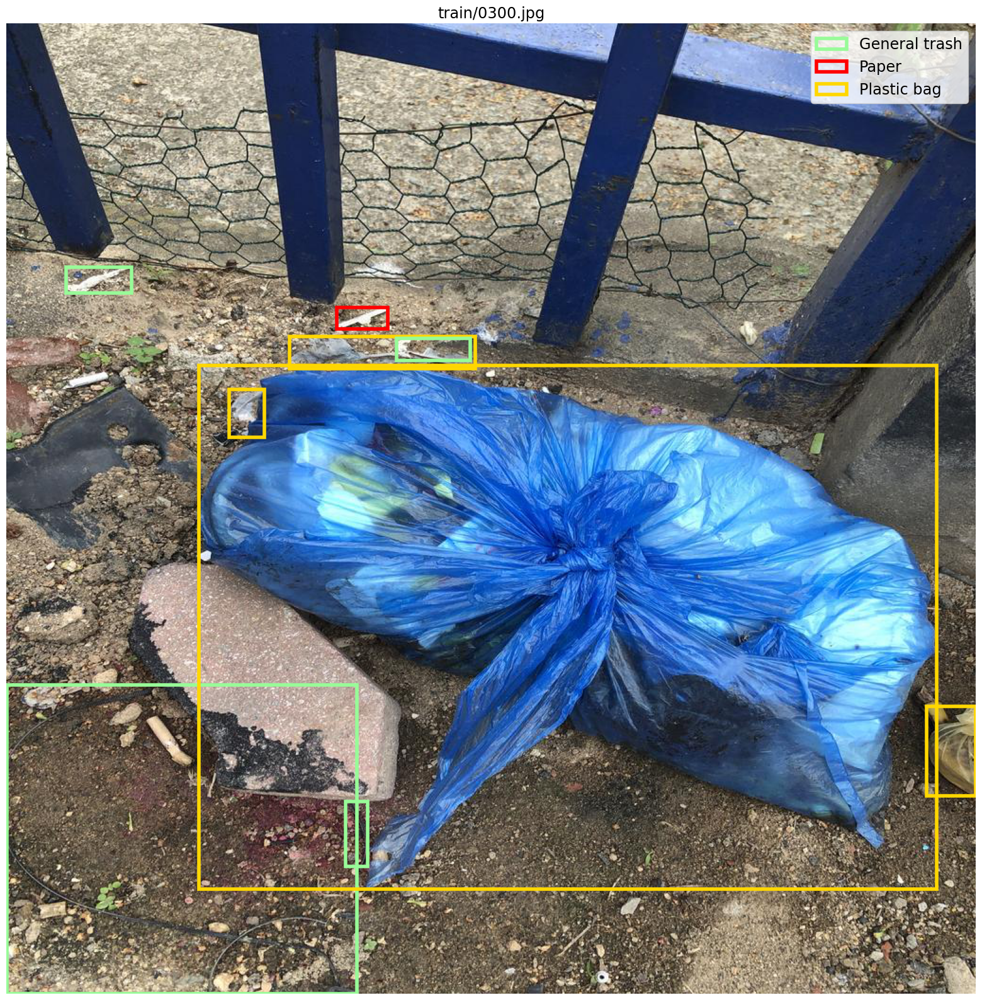

In [349]:
plot_image_img(300)

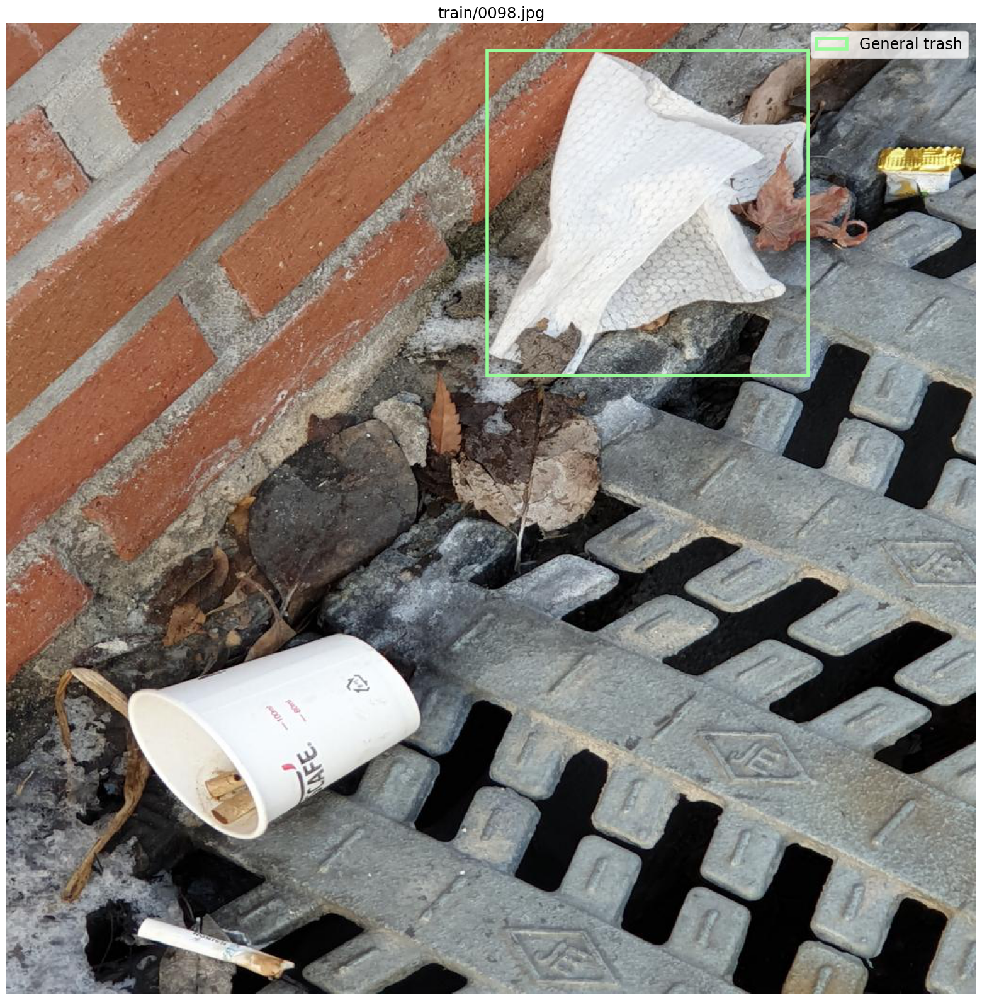

In [350]:
plot_image_idx(451)

In [351]:
from collections import Counter
display(Counter(train_df.image_id.value_counts().values))
fig = px.histogram(train_df.image_id.value_counts(), 
                   log_y=False, color_discrete_sequence=['indianred'], opacity=0.7,
                   labels={"value":"Number of Annotations Per Image"},
                   title="<b>DISTRIBUTION OF # OF ANNOTATIONS PER IMAGE   " \
                         "<i><sub>(Log Scale for Y-Axis)</sub></i></b>",
                   )
fig.update_layout(showlegend=False,
                  xaxis_title="<b>Number of Unique Images</b>",
                  yaxis_title="<b>Count of All Object Annotations</b>",)
fig.show()

Counter({71: 1,
         55: 1,
         52: 1,
         48: 1,
         46: 3,
         44: 1,
         42: 2,
         41: 1,
         40: 3,
         39: 2,
         38: 3,
         37: 3,
         35: 3,
         34: 6,
         33: 3,
         32: 9,
         31: 9,
         30: 5,
         29: 5,
         28: 13,
         27: 11,
         26: 17,
         25: 14,
         24: 16,
         23: 15,
         22: 20,
         21: 16,
         20: 23,
         19: 23,
         18: 27,
         17: 40,
         16: 49,
         15: 45,
         14: 46,
         13: 48,
         12: 66,
         11: 67,
         10: 88,
         9: 107,
         8: 102,
         7: 157,
         6: 166,
         5: 218,
         4: 259,
         3: 405,
         2: 783,
         1: 1980})

In [352]:
fig = px.box(train_df.image_id.value_counts(), 
                   log_y=False, color_discrete_sequence=['indianred'],
                   labels={"value":"Number of Annotations Per Image"},
                   title="<b>DISTRIBUTION OF # OF ANNOTATIONS PER IMAGE   " \
                         "<i><sub>(Log Scale for Y-Axis)</sub></i></b>",
                   )
fig.update_layout(showlegend=False,
                  xaxis_title="<b>Number of Unique Images</b>",
                  yaxis_title="<b>Count of All Object Annotations</b>",)
fig.show()

In [353]:
fig = px.histogram(train_df.groupby('image_id')["class_id"].unique().apply(lambda x: len(x)), 
             log_y=True, color_discrete_sequence=['skyblue'], opacity=0.7,
             labels={"value":"Number of Unique class"},
             title="<b>DISTRIBUTION OF # OF Unique Class PER IMAGE   " \
                   "<i><sub>(Log Scale for Y-Axis)</sub></i></b>",
                   )
fig.update_layout(showlegend=False,
                  xaxis_title="<b>Number of Unique CLASS</b>",
                  yaxis_title="<b>Count of Unique IMAGE</b>",)
fig.show()

In [354]:
fig = px.bar(train_df.class_name.value_counts().sort_index(), 
             color=train_df.class_name.value_counts().sort_index().index, opacity=0.85,
             color_discrete_sequence=LABEL_COLORS, log_y=False,
             labels={"y":"Annotations Per Class", "x":""},
             title="<b>Annotations Per Class</b>",)
fig.update_layout(legend_title=None,
                  xaxis_title="",
                  yaxis_title="<b>Annotations Per Class</b>")

fig.show()

  0%|          | 0/23144 [00:00<?, ?it/s]

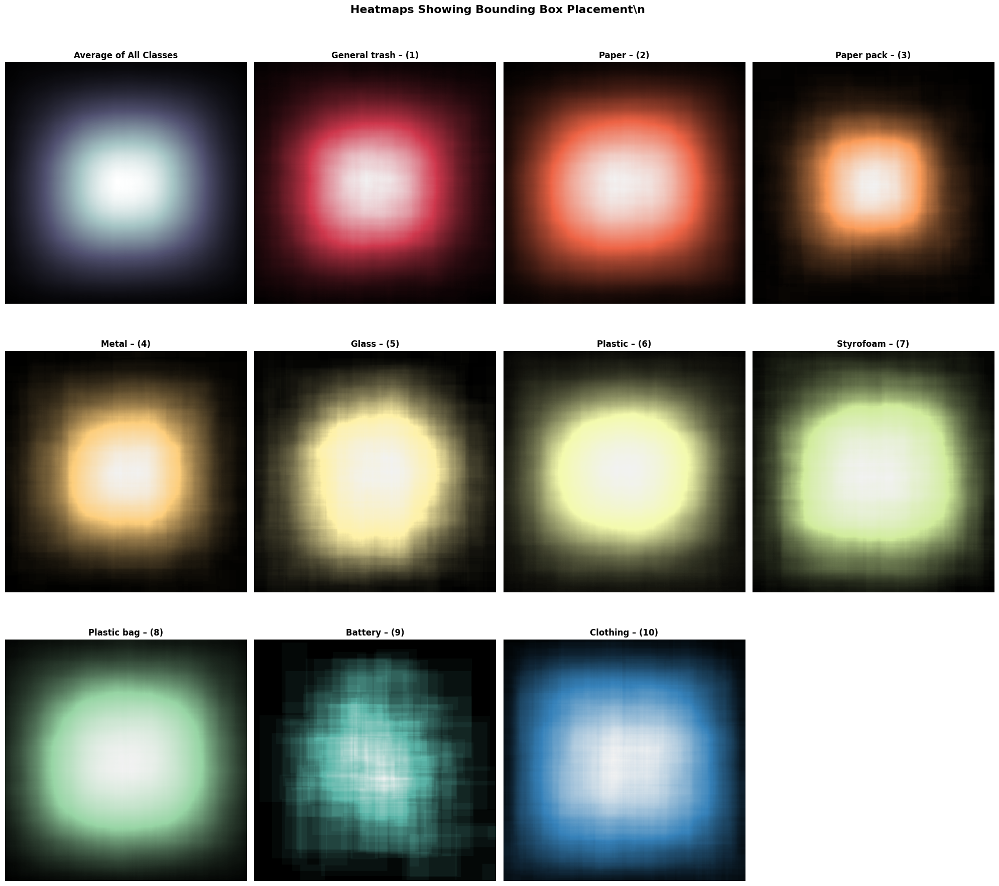

In [330]:
bbox_df = pd.DataFrame()
bbox_df['class_id'] = train_df['class_id'].values
bbox_df['class_name'] = train_df['class_name'].values
bbox_df['x_min'] = train_df['x_min'].values / 1024
bbox_df['x_max'] = train_df['x_max'].values / 1024
bbox_df['y_min'] = train_df['y_min'].values / 1024
bbox_df['y_max'] = train_df['y_max'].values / 1024
bbox_df['frac_x_min'] = train_df['x_min'].values / 1024
bbox_df['frac_x_max'] = train_df['x_max'].values / 1024
bbox_df['frac_y_min'] = train_df['y_min'].values / 1024
bbox_df['frac_y_max'] = train_df['y_max'].values / 1024

ave_src_img_height = 1024
ave_src_img_width = 1024

# DEFAULT
HEATMAP_SIZE = (ave_src_img_height, ave_src_img_width, 14)

# Initialize
heatmap = np.zeros((HEATMAP_SIZE), dtype=np.int16)
bbox_np = bbox_df[["class_id", "frac_x_min", "frac_x_max", "frac_y_min", "frac_y_max"]].to_numpy()
bbox_np[:, 1:3] *= ave_src_img_width
bbox_np[:, 3:5] *= ave_src_img_height
bbox_np = np.floor(bbox_np).astype(np.int16)

# Color map stuff
custom_cmaps = [
    matplotlib.colors.LinearSegmentedColormap.from_list(
        colors=[(0.,0.,0.), c, (0.95,0.95,0.95)], 
        name=f"custom_{i}") for i,c in enumerate(sns.color_palette("Spectral", 10))
]
# custom_cmaps.pop(8) # Remove No-Finding

for row in tqdm(bbox_np, total=bbox_np.shape[0]):
    heatmap[row[3]:row[4]+1, row[1]:row[2]+1, row[0]] += 1
    
fig = plt.figure(figsize=(20,25))
plt.suptitle("Heatmaps Showing Bounding Box Placement\\n ", fontweight="bold", fontsize=16)
for i in range(11):
    plt.subplot(4, 4, i+1)
    if i==0:
        plt.imshow(heatmap.mean(axis=-1), cmap="bone")
        plt.title(f"Average of All Classes", fontweight="bold")
    else:
        plt.imshow(heatmap[:, :, i-1], cmap=custom_cmaps[i-1])
        plt.title(f"{classes[i-1]} – ({i})", fontweight="bold")
        
    plt.axis(False)
fig.tight_layout(rect=[0, 0.03, 1, 0.97])
plt.show()


In [331]:
# Update bbox dataframe to make this easier
bbox_df["frac_bbox_area"] = (bbox_df["frac_x_max"]-bbox_df["frac_x_min"])*(bbox_df["frac_y_max"]-bbox_df["frac_y_min"])
# bbox_df["class_id_as_str"] = bbox_df["class_id"].map(classes)
display(bbox_df.head())

fig = px.box(bbox_df.sort_values(by="class_name"), x="class_name", y="frac_bbox_area", color="class_name", 
             color_discrete_sequence=LABEL_COLORS_WOUT_NO_FINDING, notched=True,
             labels={"class_name":"Class Name", "frac_bbox_area":"BBox Area (%)"},
             title="<b>DISTRIBUTION OF BBOX AREAS AS % OF SOURCE IMAGE AREA   " \
                   "<i><sub>(Some Upper Outliers Excluded For Better Visualization)</sub></i></b>")

fig.update_layout(showlegend=True,
                  yaxis_range=[-0.025,0.4],
                  legend_title_text=None,
                  xaxis_title="",
                  yaxis_title="<b>Bounding Box Area %</b>",)
fig.show()


,class_id,class_name,x_min,x_max,y_min,y_max,frac_x_min,frac_x_max,frac_y_min,frac_y_max,frac_bbox_area
0,0,General trash,0.192969,0.727930,0.189160,0.647852,0.192969,0.727930,0.189160,0.647852,0.245382
1,3,Metal,0.000000,0.056250,0.397852,0.574219,0.000000,0.056250,0.397852,0.574219,0.009921
2,7,Plastic bag,0.000000,0.141211,0.444922,0.622266,0.000000,0.141211,0.444922,0.622266,0.025043
3,4,Glass,0.705371,0.973242,0.306055,0.552051,0.705371,0.973242,0.306055,0.552051,0.065895
4,5,Plastic,0.344922,0.573145,0.655273,0.756250,0.344922,0.573145,0.655273,0.756250,0.023045


In [334]:
# Aspect Ratio is Calculated as Width/Height
bbox_df["aspect_ratio"] = (bbox_df["x_max"]-bbox_df["x_min"])/(bbox_df["y_max"]-bbox_df["y_min"])

# Display average means for each class_id so we can examine the newly created Aspect Ratio Column
display(bbox_df.groupby("class_id").mean())

# Generate the bar plot
fig = px.bar(x=classes, y=bbox_df.groupby("class_id").mean()["aspect_ratio"], 
             color=classes, opacity=0.85,
             color_discrete_sequence=LABEL_COLORS_WOUT_NO_FINDING, 
             labels={"x":"Class Name", "y":"Aspect Ratio (W/H)"},
             title="<b>Aspect Ratios For Bounding Boxes By Class</b>",)
fig.update_layout(
                  yaxis_title="<b>Aspect Ratio (W/H)</b>",
                  xaxis_title=None,
                  legend_title_text=None)
fig.add_hline(y=1, line_width=2, line_dash="dot", 
              annotation_font_size=10, 
              annotation_text="<b>SQUARE ASPECT RATIO</b>", 
              annotation_position="bottom left", 
              annotation_font_color="black")
fig.add_hrect(y0=0, y1=0.5, line_width=0, fillcolor="red", opacity=0.125,
              annotation_text="<b>>2:1 VERTICAL RECTANGLE REGION</b>", 
              annotation_position="bottom right", 
              annotation_font_size=10,
              annotation_font_color="red")
fig.add_hrect(y0=2, y1=3.5, line_width=0, fillcolor="green", opacity=0.04,
              annotation_text="<b>>2:1 HORIZONTAL RECTANGLE REGION</b>", 
              annotation_position="top right", 
              annotation_font_size=10,
              annotation_font_color="green")
fig.show()

,x_min,x_max,y_min,y_max,frac_x_min,frac_x_max,frac_y_min,frac_y_max,frac_bbox_area,aspect_ratio
class_id,,,,,,,,,,
0,0.383549,0.604483,0.394808,0.605228,0.383549,0.604483,0.394808,0.605228,0.075207,1.433186
1,0.375895,0.633562,0.375408,0.606554,0.375895,0.633562,0.375408,0.606554,0.087780,1.391648
2,0.378863,0.618020,0.408042,0.622968,0.378863,0.618020,0.408042,0.622968,0.072590,1.296333
3,0.387037,0.632183,0.368833,0.620011,0.387037,0.632183,0.368833,0.620011,0.087399,1.239462
4,0.401057,0.602315,0.388950,0.654449,0.401057,0.602315,0.388950,0.654449,0.066126,1.043987
5,0.391260,0.625025,0.386217,0.611491,0.391260,0.625025,0.386217,0.611491,0.077239,1.288092
6,0.352261,0.644397,0.368552,0.614946,0.352261,0.644397,0.368552,0.614946,0.093069,1.474087
7,0.368910,0.637833,0.341409,0.635559,0.368910,0.637833,0.341409,0.635559,0.105245,1.106761
8,0.401370,0.624880,0.422020,0.631976,0.401370,0.624880,0.422020,0.631976,0.048075,1.428327


In [335]:
exp = train_df.copy()
exp['ratio'] = (exp.x_max - exp.x_min) / (exp.y_max - exp.y_min)
display(exp)

fig = px.box(exp.sort_values(by="class_name"), x="class_name", y="ratio", color="class_name", 
             color_discrete_sequence=LABEL_COLORS_WOUT_NO_FINDING, notched=True,
             labels={"class_name":"Class Name", "ratio":"Aspect Ratio (W / H)"},
             title="<b>DISTRIBUTION OF ASPECT RATIO AS WIDTH/HEIGHT OF BOUNDING BOX   ")

fig.update_layout(showlegend=True,
                  yaxis_range=[0, 10],
                  legend_title_text=None,
                  xaxis_title="",
                  yaxis_title="<b>Aspect Ratio Width/Height</b>",)
fig.add_hline(y=1, line_width=2, line_dash="dot", 
              annotation_font_size=10, 
              annotation_text="<b>SQUARE ASPECT RATIO</b>", 
              annotation_position="bottom left", 
              annotation_font_color="black")
fig.add_hrect(y0=0, y1=0.5, line_width=0, fillcolor="red", opacity=0.125,
              annotation_text="<b>>2:1 VERTICAL RECTANGLE REGION</b>", 
              annotation_position="bottom right", 
              annotation_font_size=10,
              annotation_font_color="red")
fig.add_hrect(y0=2, y1=3.5, line_width=0, fillcolor="green", opacity=0.04,
              annotation_text="<b>>2:1 HORIZONTAL RECTANGLE REGION</b>", 
              annotation_position="top right", 
              annotation_font_size=10,
              annotation_font_color="green")
fig.show()

,image_id,class_name,class_id,x_min,y_min,x_max,y_max,ratio
0,train/0000.jpg,General trash,0,197.6,193.7,745.4,663.4,1.166276
1,train/0001.jpg,Metal,3,0.0,407.4,57.6,588.0,0.318937
2,train/0001.jpg,Plastic bag,7,0.0,455.6,144.6,637.2,0.796256
3,train/0001.jpg,Glass,4,722.3,313.4,996.6,565.3,1.088924
4,train/0001.jpg,Plastic,5,353.2,671.0,586.9,774.4,2.260155
...,...,...,...,...,...,...,...,...
23139,train/4882.jpg,Plastic,5,0.0,116.2,944.1,930.3,1.159686
23140,train/4882.jpg,Plastic bag,7,302.1,439.3,567.3,655.4,1.227210
23141,train/4882.jpg,General trash,0,511.3,451.1,570.0,481.3,1.943709
23142,train/4882.jpg,Paper,1,255.0,421.4,526.7,616.5,1.392619


In [337]:
img_per_cls = [train_df[train_df['class_id'] == i]['image_id'].nunique() for i in range(10)]

trace1 = go.Bar(x=classes, y=img_per_cls, name='number of images for a class')

data = [trace1]
layout = go.Layout(title='NUMBER OF IMAGES FOR EACH CLASS')
fig = go.Figure(data=data, layout=layout)
fig.show()

In [336]:
box_per_cls = [len(train_df[train_df['class_id'] == i]) for i in range(10)]

trace1 = go.Bar(x=classes, y=box_per_cls, name='number of boxes for a class')
trace2 = go.Bar(x=classes, y=img_per_cls, name='number of images for a class')

data = [trace1, trace2]
layout = go.Layout(title='NUMBER OF BOXES AND IMAGES FOR EACH CLASS')
fig = go.Figure(data=data, layout=layout)
fig.show()

In [295]:
train_df[train_df.class_id == 9]

,image_id,class_name,class_id,x_min,y_min,x_max,y_max
41,train/0007.jpg,Clothing,9,109.0,104.7,860.7,581.6
42,train/0007.jpg,Clothing,9,95.4,438.7,804.1,991.1
72,train/0014.jpg,Clothing,9,586.4,194.4,874.9,839.8
73,train/0014.jpg,Clothing,9,158.5,260.7,490.9,856.3
75,train/0014.jpg,Clothing,9,175.7,97.9,347.4,332.6
...,...,...,...,...,...,...,...
23019,train/4850.jpg,Clothing,9,511.2,429.0,749.9,613.2
23020,train/4850.jpg,Clothing,9,264.6,643.7,592.7,849.6
23046,train/4856.jpg,Clothing,9,459.5,340.3,782.5,516.0
23047,train/4856.jpg,Clothing,9,294.9,355.6,619.0,598.6


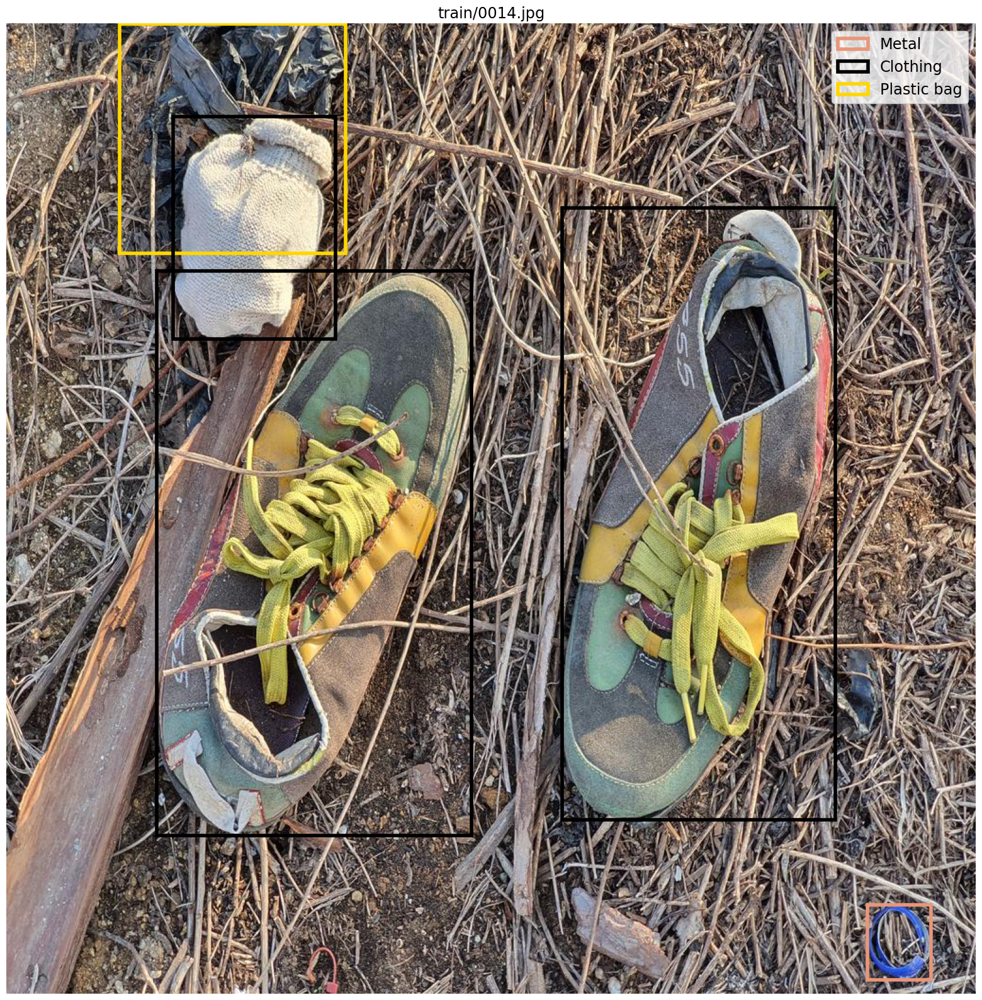

In [298]:
plot_image_img(14)